In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Exercicío Programa 3

#### Implementação do método de Runge-Kutta de quarta ordem para a resolução numérica de um sistema de Equações Diferenciais Ordinárias

Aluno: Higor Eduardo Marques  
Matrícula: 22203133

# O problema

Foi dado um modelo matemático que representa o espalhamento de uma doença.  
O modelo é dado por um sistema de três equações diferenciais ordinárias (EDOs):

<p style="text-align: left;">
$$
\frac{dS}{dt} = -\beta SI,
$$
$$
\frac{dI}{dt} = \beta SI - \gamma I,
$$
$$
\frac{dR}{dt} = \gamma I,
$$
</p>
Sendo β um parâmetro que quantifica a taxa de infecção e γ a taxa de recuperação.  

O problema consiste na aproximação das funções S(t), I(t), R(t), por meio do método de Runge-Kutta de quarta ordem, em um intervalo de tempo [t0, tN], com β e γ parâmetros do modelo e com as condições iniciais S(t0) = S0, I(t0) = I0 e R(t0) = R0.

## Condições iniciais

`β = 10/(40·8·24)`  
`γ = 3/(15·24)`  

`S0 = 49`  
`I0 = 1`  
`R0 = 0`  
`tn = 25 dias`  

# Solução

## Definindo as EDOs dadas

In [2]:
def dS_h(S, I, beta):
    return (beta * S * I) * -1

def dI_h(S, I, beta, gamma):
    return beta * S * I - gamma * I

def dR_h(I, gamma):
    return gamma * I

## Definindo função para facilitar visualização de gráficos

In [3]:
def get_plot(s, i, r, t, title):
    plt.plot(t, s, label='Suscetíveis')
    plt.plot(t, i, label='Infectados')
    plt.plot(t, r, label='Removidos')
    plt.title(title)
    plt.xlabel('Tempo [horas]')
    plt.ylabel('Pessoas')
    plt.grid(True)
    plt.legend()

## Aplicando o método de Runge-Kutta de quarta ordem

De acordo com [1], o método de Runge-Kutta de quarta ordem consiste em:

$$
y_{k+1} = y_k + h \frac{(K_1 + 2K_2 + 2K_3 + K_4)}{6}
$$
$$
x_{k+1} = x_k + h
$$
em que
$$
K_1 = f(x_k, y_k)
$$
$$
K_2 = f\left(x_k + \frac{h}{2}, y_k + \frac{h}{2} K_1\right)
$$
$$
K_3 = f\left(x_k + \frac{h}{2}, y_k + \frac{h}{2} K_2\right)
$$
$$
K_4 = f(x_k + h, y_k + h \cdot K_3)
$$

Em seguida o método foi aplicado para a solução do problema dado.

In [4]:
def runge_kutta(initial_S, initial_I, initial_R, max_interval, h, beta, gamma):
    N_t = int(max_interval / h)
    time = np.linspace(0, N_t * h, N_t + 1)

    S = np.zeros(N_t + 1)
    I = np.zeros(N_t + 1)
    R = np.zeros(N_t + 1)

    S[0] = initial_S
    I[0] = initial_I
    R[0] = initial_R

    for k in range(N_t):
        k1_s = h * dS_h(S[k], I[k], beta)
        k1_i = h * dI_h(S[k], I[k], beta, gamma)
        k1_r = h * dR_h(I[k], gamma)

        k2_s = h * dS_h(S[k] + k1_s / 2, I[k] + k1_i / 2, beta)
        k2_i = h * dI_h(S[k] + k1_s / 2, I[k] + k1_i / 2, beta, gamma)
        k2_r = h * dR_h(I[k] + k1_i / 2, gamma)

        k3_s = h * dS_h(S[k] + k2_s / 2, I[k] + k2_i / 2, beta)
        k3_i = h * dI_h(S[k] + k2_s / 2, I[k] + k2_i / 2, beta, gamma)
        k3_r = h * dR_h(I[k] + k2_i / 2, gamma)

        k4_s = h * dS_h(S[k] + k3_s, I[k] + k3_i, beta)
        k4_i = h * dI_h(S[k] + k3_s, I[k] + k3_i, beta, gamma)
        k4_r = h * dR_h(I[k] + k3_i, gamma)

        S[k + 1] = S[k] + (k1_s + 2 * k2_s + 2 * k3_s + k4_s) / 6
        I[k + 1] = I[k] + (k1_i + 2 * k2_i + 2 * k3_i + k4_i) / 6
        R[k + 1] = R[k] + (k1_r + 2 * k2_r + 2 * k3_r + k4_r) / 6

    return S, I, R, time

## Definindo as condições iniciais

In [5]:
beta = 10.0 / (40 * 8 * 24)
gamma = 3.0 / (15 * 24)

S0 = 49
I0 = 1
R0 = 0
t_n = 25 * 24 # [horas]

h = 0.1 # [horas] passo de 6 minutos

## Rodando a função com os parâmetros iniciais

In [6]:
s, i, r, t = runge_kutta(S0, I0, R0, t_n, h, beta, gamma)

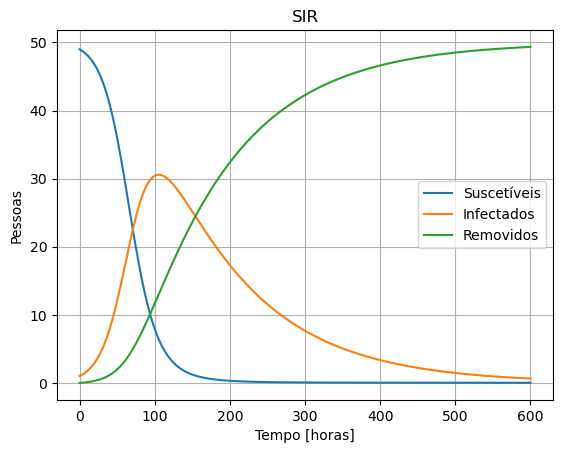

In [7]:
get_plot(s, i, r, t, "SIR")
plt.show()

## Rodando a função com β reduzido

In [8]:
s2, i2, r2, t2 = runge_kutta(S0, I0, R0, t_n, h, beta / 2, gamma)
s5, i5, r5, t5 = runge_kutta(S0, I0, R0, t_n, h, beta / 5, gamma)

### Definindo tamanho da visualização dos gráficos

In [9]:
wihh_pixels = 1500
height_pixels = 500
dpi = 100
wihh_inch = wihh_pixels / dpi
height_inch = height_pixels / dpi

### Plotando os gráficos

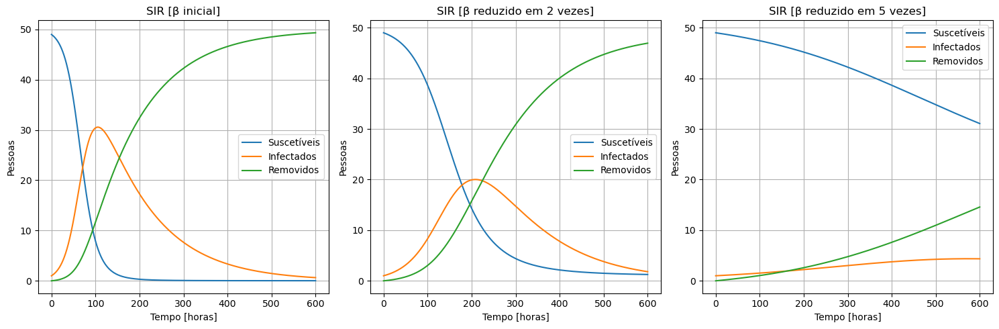

In [10]:
plt.figure(figsize=(wihh_inch, height_inch), dpi=dpi)

plt.subplot(1, 3, 1)
get_plot(s, i, r, t, "SIR [β inicial]")

plt.subplot(1, 3, 2)
get_plot(s2, i2, r2, t2, "SIR [β reduzido em 2 vezes]")

plt.subplot(1, 3, 3)
get_plot(s5, i5, r5, t5, "SIR [β reduzido em 5 vezes]")

plt.tight_layout()
plt.show()


## Visualização de um gráfico animado à medida que β reduz

In [11]:
fig, ax = plt.subplots()
line_S, = ax.plot([], [], 'blue', label='Suscetíveis')
line_I, = ax.plot([], [], 'orange', label='Infectados')
line_R, = ax.plot([], [], 'green', label='Recuperados')

def init():
    ax.set_xlim(0, t_n)
    ax.set_ylim(0, 50)
    ax.set_xlabel('Tempo [horas]')
    ax.set_ylabel('Pessoas')
    ax.legend()
    ax.grid(True)
    return line_S, line_I, line_R

def update(reduc):
    beta = (10.0 / (40 * 8 * 24)) / reduc
    S, I, R, t_values = runge_kutta(S0, I0, R0, t_n, h, beta, gamma)
    line_S.set_data(t_values, S)
    line_I.set_data(t_values, I)
    line_R.set_data(t_values, R)
    ax.set_title(f"SIR [β reduzido em {reduc:.2f} vezes]")
    return line_S, line_I, line_R

fps = 60
interval = 1000 /fps

ani = FuncAnimation(fig, update, frames=np.arange(1, 10, 0.05), init_func=init, interval=interval, blit=True)
plt.close()

In [12]:
HTML(ani.to_jshtml())

## Da definição do passo `h`

In [13]:
fig, ax = plt.subplots()
line_S, = ax.plot([], [], 'blue', label='Suscetíveis')
line_I, = ax.plot([], [], 'orange', label='Infectados')
line_R, = ax.plot([], [], 'green', label='Recuperados')

def init():
    ax.set_xlim(0, t_n)
    ax.set_ylim(0, 50)
    ax.set_xlabel('Tempo [horas]')
    ax.set_ylabel('Pessoas')
    ax.legend()
    ax.grid(True)
    return line_S, line_I, line_R

def update(h):
    S, I, R, t_values = runge_kutta(S0, I0, R0, t_n, h, beta, gamma)
    line_S.set_data(t_values, S)
    line_I.set_data(t_values, I)
    line_R.set_data(t_values, R)
    ax.set_title(f"SIR [h = {h:.1f}]")
    return line_S, line_I, line_R

fps = 60
interval = 1000 /fps

ani = FuncAnimation(fig, update, frames=np.arange(100, 1, -0.5), init_func=init, interval=interval, blit=True)
plt.close()

À partir do gráfico abaixo, é possível inferir que com à medida que `h` diminui, o gráfico fica mais suavizado. Ou seja, o erro entre cada espaçamento entre dois pontos calculados pelo método de Runge-Kutta diminui.

In [14]:
HTML(ani.to_jshtml())

# Conclusão

Foram obtidos resultados satisfatórios na implementação do método de Runge-Kutta de quarta ordem. Ao longo do desenvolvimento, foi possível explorar em detalhes tanto a teoria quanto a prática da integração numérica, evidenciando a eficácia do método na obtenção de soluções aproximadas com alta precisão.  

É importante considerar as limitações inerentes ao método, como a necessidade de passos de tempo adequados para garantir a convergência e a precisão desejadas. Ademais, em sistemas muito complexos ou com comportamentos não-lineares, o ajuste fino dos parâmetros e a análise crítica dos resultados são essenciais para evitar erros de interpretação.

# Referências

[1] Sergio Peters e Julio F. Szeremeta (2019) Cálculo Numérico Computacional, Editora da UFSC.